In [1]:
from IPython.display import display
from IPython.display import HTML
import IPython.core.display as di # Example: di.display_html('<h3>%s:</h3>' % str, raw=True)

# This line will hide code by default when the notebook is exported as HTML
di.display_html('<script>jQuery(function() {if (jQuery("body.notebook_app").length == 0) { jQuery(".input_area").toggle(); jQuery(".prompt").toggle();}});</script>', raw=True)

# This line will add a button to toggle visibility of code blocks, for use with the HTML export version
di.display_html('''<button onclick="jQuery('.input_area').toggle(); jQuery('.prompt').toggle();">Toggle code</button>''', raw=True)

Toggle code

In [2]:
import os
from pathlib import Path
import pandas as pd
import numpy as np
import boto3
import datetime
import matplotlib.pyplot as plt
from matplotlib.dates import DateFormatter, DayLocator
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import fun_eda, fun_s3

In [3]:
####################################  CARGAMOS BASE ORIGINAL
bucket_name = 'movicovid'
fname = '{}/{}/{}'.format('data', 'dataforgood', 'movimientos_entre_administraciones_08062020.csv')
original_data = fun_s3.abre_file_como_df(bucket_name, fname)

####################################   CAMBIO TIPO DE VARIABLES
original_data['starting_region_name'] = original_data['starting_region_name'].astype('category')
original_data['ending_region_name'] = original_data['ending_region_name'].astype('category')
original_data['fecha'] = pd.to_datetime(original_data['fecha'])
original_data['hr'] = original_data['hora'].str.slice(start=0, stop=2).astype(int)

####################################   SELECCIONAMOS VARIABLES DE INTERES
data = original_data[['difference', 'baseline_people_moving', 'crisis_people_moving', 'starting_region_name', 'percent_change',
                     'ending_region_name', 'length_km', 'hr','fecha']].copy()

####################################  DROP REGISTROS DUPLICADOS
# elimina todos, menos el primero
data.drop_duplicates(subset = ['difference', 'baseline_people_moving', 'crisis_people_moving', 'starting_region_name',
                               'percent_change', 'ending_region_name', 'length_km', 'hr','fecha'], 
                              keep = 'first', inplace = True) 

In [4]:
delegaciones = ["Álvaro Obregón", "Azcapotzalco", "Benito Juárez", "Coyoacán", "Cuajimalpa de Morelos", "Cuauhtémoc",
                "Gustavo A. Madero", "Iztacalco", "Iztapalapa", "La Magdalena Contreras", "Miguel Hidalgo", "Milpa Alta",
                "Tláhuac", "Tlalpan", "Venustiano Carranza", "Xochimilco"]

alc_mun = pd.Series(data['starting_region_name'].unique()).append(pd.Series(data['ending_region_name'].unique())).unique()

municipios = alc_mun[~alc_mun.isin(delegaciones)]

In [5]:
alc_mun[~alc_mun.isin(delegaciones)]

[Tultitlán, Ixtapaluca, Chalco, Temamatla, Cuautitlán, ..., Coacalco de Berriozábal, Cocotitlán, Tenango del Aire, Tultepec, Melchor Ocampo]
Length: 50
Categories (66, object): [Azcapotzalco, Benito Juárez, Tultitlán, Tlalpan, ..., Tenango del Aire, Tultepec, Melchor Ocampo, Cuauhtémoc]

In [6]:
####################################   TRANSFORMACION DE VARIABLES  ####################################

#### Añado columnas que indican si el Origen/Destino es en CDMX
data = data.assign(ori_cdmx=np.where(data["starting_region_name"].isin(delegaciones), 'CDMX', 'Otro'), 
                   des_cdmx=np.where(data["ending_region_name"].isin(delegaciones), 'CDMX', 'Otro'))

### Añado una columna que contabilice el numero de semanas
data['num_semana'] = data['fecha'].dt.week

### Añado una columna para el dia de la semana
dict_days = {0:'Lunes',1:'Martes',2:'Miércoles',3:'Jueves',4:'Viernes',5:'Sábado',6:'Domingo'}
data['dia_semana'] = data['fecha'].dt.dayofweek.map(dict_days)

### Anado una columna para identificar la ruta
data['ruta'] = data['starting_region_name'].astype(str) + " - " + data['ending_region_name'].astype(str)


# Movicovid

## Contexto

El 23 de Marzo, se inicio oficialmente, la Jornada Nacional de Sana distancia, que se planteó inicialmente para el período del 23 de Marzo al 19 de Abril. Las medidas de esta campaña incluyeron la suspensión temporal de actividades escolares, la suspensión temporal de actividades no esenciales, la reprogramación de los eventos de concentración masiva, y el **repliegue familiar en casa**, es decir, el mantenerse en casa tratando de respetar la sana distancia de 1.5 metros entre los miembros de la familia.

  - **23 de Marzo 2020**. Inicia Fase 2 y la Jornada Nacional de Sana Distancia [1](http://www.imss.gob.mx/prensa/archivo/202003/142), [2](https://www.dof.gob.mx/nota_detalle.php?codigo=5590339&fecha=24/03/2020), [3](https://www.gob.mx/salud/prensa/095-inicia-fase-2-por-coronavirus-covid-19).
  - **30 de Marzo 2020**. Declaración de Emergencia Sanitaria [4](https://dof.gob.mx/nota_detalle.php?codigo=5590745&fecha=30/03/2020).
  - **21 de Abril 2020**. Inicia Fase 3 por COVID-19 [5](https://www.gob.mx/salud/prensa/110-inicia-la-fase-3-por-covid-19).  Se extiende la Jornada Nacional de Sana Distancia hasta el 30 de mayo de 2020, [6](https://www.dof.gob.mx/nota_detalle.php?codigo=5592067&fecha=21/04/2020).
  - **1 de Junio 2020**. Concluye la Jornada Nacional de Sana Distancia. Inician actividades los sectores neo-esenciales como minería, construcción e industria automotriz, bajo protocolos de seguridad enfocados a evitar contagios en los centros de trabajo [7](http://www.imss.gob.mx/prensa/archivo/202005/356).

Por su parte, y acorde con la política nacional de *#QuédateEnCasa* y *#SanaDistancia*, el Gobierno de la Ciudad de México también suspendió actividades y establecimientos del 23 de Marzo al 19 de Abril, [8](https://www.cdmx.gob.mx/portal/articulo/cierre-temporal-de-actividades-y-establecimientos-por-covid-19). El 31 de Marzo, se dio a conocer que únicamente se mantendrían activos los establecimientos relacionados con servicios de salud, alimentación e indispensables, como gasolineras y bancos, cerrando centros comerciales y otros estableciomientos considerados no escenciales, [9](https://www.cdmx.gob.mx/portal/articulo/cierre-de-centros-comerciales-por-emergencia-sanitaria). El 24 de abril, se cerraron el 20% de las estaciones del Metro, Metrobús y Tren Ligero, y el Hoy No Circula se aplicó para todos los vehículos particulares, con algunas excepciones, [10](https://www.cdmx.gob.mx/portal/articulo/nuevas-medidas-para-la-fase-3-por-covid-9). El 22 de Mayo, se dio a conocer el plan gradual hacia la nueva normalidad, [11](https://www.cdmx.gob.mx/portal/articulo/plan-gradual-hacia-la-nueva-normalidad), [12](https://covid19.cdmx.gob.mx/storage/app/media/plan%20gradual%20hacia%20la%20nueva%20normalidad%20en%20la%20ciudad%20de%20mexico/plangradualhacialanuevanormalidadenlaciudaddemexico20.pdf). El 1 de Julio, se retomaron actividades económicas esenciales, [13](https://www.cdmx.gob.mx/portal/articulo/lineamientos-para-industrias-que-retoman-actividades).


Sin embargo, algunas fuentes periodísticas han afirmado que parte de la población no pudo quedarse en casa durante el período, [14](https://www.elfinanciero.com.mx/nacional/en-mexico-apenas-35-ha-respetado-el-quedate-en-casa-revela-google), [15](https://www.animalpolitico.com/2020/04/municipios-cumplen-quedate-en-casa-covid-19/).

# Total de Rutas

El siguiente análisis considera el **baseline original** de la fuente, por ruta (origen-destino) día de la semana y hora, como base para las comparaciones.

En el análisis previo encontró que de las 23,959 rutas distintas por día, hora y semana, sólo en el 0.14% (35 casos)el baseline es inconsistente, es decir, no es único.

Así, los 239,062 registros de rutas se distribuyen de la siguiente manera:

   - Las rutas con origen y destino fuera de la CDMX representan el 40% de las rutas en la base, mientras que las que tienen origen y destino en la CDMX son el 23.7%.

   - La distribución de las rutas por hora, según su origen destino, se mantiene casi constante a lo largo de las 3 ventanas de tiempo para las rutas con origen y destino fuera de la CDMX.

   - Para las rutas con origen y destino en la CDMX, también se mantuvieron relativamente constantes a lo largo del día.

   - Las rutas con origen fuera de la CDMX y destino en la CDMX concentraron el 22% y 20% a las 8 y 16 horas, pero disminuyeron hasta 14% para las 00 horas. Inversamente, las rutas con origen en la CDMX y destino fuera de la CDMX aumentaron a 23% a las 00 horas, de 13% y 16% a las 8 y 6 horas.

In [7]:
total_rutas = len(data)
rutas = data.groupby(['ori_cdmx', 'des_cdmx']).size()
rutas = rutas.reset_index()  
rutas.columns = ['Origen', 'Destino', 'Rutas']
rutas = rutas.pivot_table(index='Origen', columns='Destino', values='Rutas')
rutas_prop = rutas.divide(total_rutas) * 100

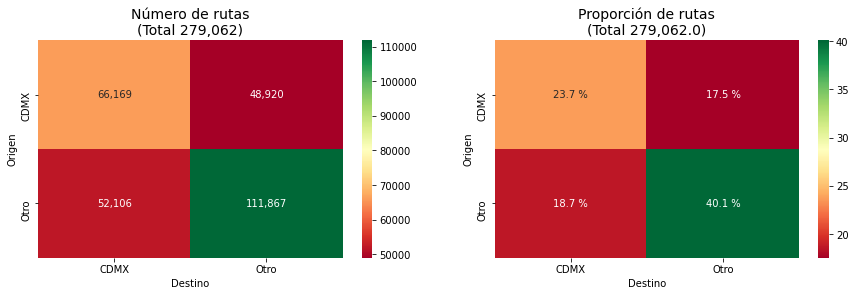

In [8]:
fig, ax = plt.subplots(1, 2, figsize=(15, 4))

sns.heatmap( rutas, annot=True, fmt='0,.0f', cmap='RdYlGn', ax=ax[0])
ax[0].set_title('Número de rutas\n(Total {:0,.0f})'.format(total_rutas), fontsize=14)

sns.heatmap( rutas_prop, annot=True, fmt='0,.1f', cmap='RdYlGn', ax=ax[1])
ax[1].set_title('Proporción de rutas\n(Total {:0,.1f})'.format(total_rutas), fontsize=14)
for t in ax[1].texts: t.set_text(t.get_text() + " %")


plt.show()

In [9]:
ruta_hora = data.groupby(['ori_cdmx', 'des_cdmx', 'hr']).size()
ruta_hora = ruta_hora.reset_index()  
ruta_hora.columns = ['Origen', 'Destino', 'hr', 'Rutas']

ruta0 = ruta_hora[ruta_hora['hr']==0].pivot_table(index='Origen', columns='Destino', values='Rutas')
ruta8 = ruta_hora[ruta_hora['hr']==8].pivot_table(index='Origen', columns='Destino', values='Rutas')
ruta16 = ruta_hora[ruta_hora['hr']==16].pivot_table(index='Origen', columns='Destino', values='Rutas')

ruta0_prop = ruta0.divide(ruta0.values.sum())*100
ruta8_prop = ruta8.divide(ruta8.values.sum())*100
ruta16_prop = ruta16.divide(ruta16.values.sum())*100

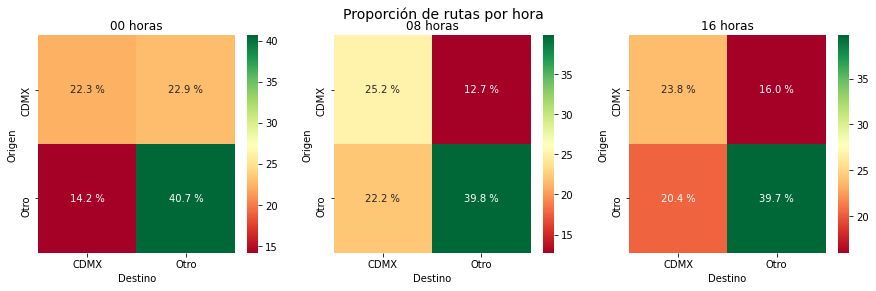

In [10]:
fig, ax = plt.subplots(1, 3, figsize=(15, 4))

sns.heatmap( ruta0_prop, annot=True, fmt='0,.1f', cmap='RdYlGn', ax=ax[0])
ax[0].set_title('00 horas')
for t in ax[0].texts: t.set_text(t.get_text() + " %")

sns.heatmap( ruta8_prop, annot=True, fmt='0,.1f', cmap='RdYlGn', ax=ax[1])
ax[1].set_title('08 horas')
for t in ax[1].texts: t.set_text(t.get_text() + " %")

sns.heatmap( ruta16_prop, annot=True, fmt='0,.1f', cmap='RdYlGn', ax=ax[2])
ax[2].set_title('16 horas')
for t in ax[2].texts: t.set_text(t.get_text() + " %")

fig.suptitle('Proporción de rutas por hora', fontsize=14)
plt.show()
#plt.tight_layout()

### Número de personas transitando las rutas

En términos del número de personas que transitan las rutas el 95% se reparte entre rutas con origen y destino en la CDMX y, rutas con origen y destino fuera de la CDMX. El restante 5% de las personas que transitan, lo hace de municipios fuera de la CDMX a las alcaldías de la CDMX o viceversa.

In [11]:
ruta_hora = data.groupby(['ori_cdmx', 'des_cdmx', 'hr']).sum()['crisis_people_moving']
ruta_hora = ruta_hora.reset_index()  
ruta_hora.columns = ['Origen', 'Destino', 'hr', 'Rutas']

ruta0 = ruta_hora[ruta_hora['hr']==0].pivot_table(index='Origen', columns='Destino', values='Rutas')
ruta8 = ruta_hora[ruta_hora['hr']==8].pivot_table(index='Origen', columns='Destino', values='Rutas')
ruta16 = ruta_hora[ruta_hora['hr']==16].pivot_table(index='Origen', columns='Destino', values='Rutas')

ruta0_prop = ruta0.divide(ruta0.values.sum())*100
ruta8_prop = ruta8.divide(ruta8.values.sum())*100
ruta16_prop = ruta16.divide(ruta16.values.sum())*100

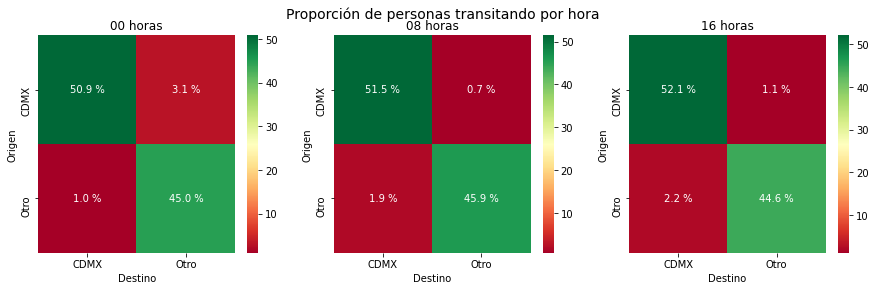

In [12]:
fig, ax = plt.subplots(1, 3, figsize=(15, 4))

sns.heatmap( ruta0_prop, annot=True, fmt='0,.1f', cmap='RdYlGn', ax=ax[0])
ax[0].set_title('00 horas')
for t in ax[0].texts: t.set_text(t.get_text() + " %")

sns.heatmap( ruta8_prop, annot=True, fmt='0,.1f', cmap='RdYlGn', ax=ax[1])
ax[1].set_title('08 horas')
for t in ax[1].texts: t.set_text(t.get_text() + " %")

sns.heatmap( ruta16_prop, annot=True, fmt='0,.1f', cmap='RdYlGn', ax=ax[2])
ax[2].set_title('16 horas')
for t in ax[2].texts: t.set_text(t.get_text() + " %")

fig.suptitle('Proporción de personas transitando por hora', fontsize=14)
plt.show()

# Inter-rutas e Intra-rutas

Separaremos el análisis para considerar dos conjuntos de datos:

   1. Inter-rutas: Rutas cuyo origen y destino pertenece a municipios o alcaldías diferentes 
   2. Intra-rutas: Rutas con origen y destino en el mismo municipio o alcandía

También haremos el análisis de las rutas separandolas según la ventana de tiempo en que se recorrieron:

   - 08 horas: de las 01:00 a las 8:00 horas
   - 16 horas: de las 09:00 a las 16:00 horas
   - 00 horas: de las 07:00 a las 24:00 horas
 
El número de rutas en cada caso son las siguientes:

| Tipo  | 08 horas | 16 horas | 00 horas | Total |
|:-----:|:--------:|:--------:|:--------:|:-----:|
|Inter-rutas|  1,140   |  1,250   |   1,372  | 3,762 |
|Intra-rutas|     66   |     66   |      66  |   198 |
|Total  |  1,206   |   1,316  |    1,438 | 3,960 |


In [13]:
# Definimos los conjuntos de datos 
# Rutas entre alcaldias/municipios
inter_rutas = data[data['starting_region_name']!=data['ending_region_name']]

# Rutas en el mismo municipio/alcaldia
intra_rutas = data[data['starting_region_name']==data['ending_region_name']]

In [14]:
# Number of unique rutes in each set of data
print("Inter: ", inter_rutas['ruta'].unique().shape[0])
print("Intra: ", intra_rutas['ruta'].unique().shape[0])

Inter:  1505
Intra:  66


In [15]:
#numero de rutas por horario
hora = 16
len(inter_rutas.groupby(['hr', 'ruta']).size().loc[(hora,)])

len(intra_rutas.groupby(['hr','ruta']).size().loc[(hora,)])

66

In [16]:
 # Grafica para determinar los límites de los grupos
def grafica_define_grupos(x_info, y_info, flag):
    
    fig, ax = plt.subplots(figsize=(20,5))
    
    ax = sns.scatterplot(x=x_info, y=y_info)
    plt.axhline(y=0, color='red', linestyle='dashed')
        
    # Encontramos los cuartiles
    grupos = pd.cut(y_info, 4)
    #graficamos una linea en el extremo derecho del cuartil
    for i in range(0,4):
        num = grupos.cat.categories[i].right
        plt.axhline(y=num, color='blue', linestyle='dashed')
    
    if flag==0:
        plt.title('Promedio de cambio de las rutas a lo largo del periodo', fontsize='16')
    else:
        plt.title('Porcentaje de NaN a lo largo del periodo', fontsize='16')
    plt.xticks(fontsize='5', rotation='vertical')
    plt.show()

In [17]:
# Funcion para determinar las rutas que pertenecen a los grupos
# los grupos se calculan con base al promedio 
def asignar_rutas_en_grupos(df_rutas, y_info):
    
    # Encontramos los cuartiles
    grupos = pd.cut(y_info, 4)
    
    #Encontramos las rutas que pertenecen a cafa grupo
    index_grupo1 =  grupos[grupos == grupos.cat.categories[0]].index
    grupo1 = df_rutas.loc[index_grupo1]

    index_grupo2 =  grupos[grupos == grupos.cat.categories[1]].index
    grupo2 = df_rutas.loc[index_grupo2]

    index_grupo3 =  grupos[grupos == grupos.cat.categories[2]].index
    grupo3 = df_rutas.loc[index_grupo3]

    index_grupo4 =  grupos[grupos == grupos.cat.categories[3]].index
    grupo4 = df_rutas.loc[index_grupo4]
    
    return grupo1, grupo2, grupo3, grupo4, grupos.cat.categories

In [18]:
# Graficas por grupos
# Cambio porcentual diario por ruta, todo el periodo

#rutas = grupo1.index
#dias = grupo1.columns

def grafica_cambio_en_en_tiempo_grupos(df_grupo, rutas, dias, group_name, flag):
    #df_grupo: df que contiene las rutas
    #rutas: array con los nombres de las rutas
    #dias: array con los dias del periodo
    #group_name: str con el nombre del grupo
    #flag: para cambiar el titulo
    sns.set_style("darkgrid")
    fig, ax = plt.subplots(figsize=(20,10))
    
    for ruta in rutas:
        #ax.plot(df_grupo.loc[ruta])
        ax.scatter(x=df_grupo.columns, y=df_grupo.loc[ruta])
    plt.axhline(y=0, color='red', linestyle='solid')
    
    myFmt = DateFormatter("%d-%b-%Y")
    ax.xaxis.set_major_formatter(myFmt)
    ax.xaxis.set_major_locator(DayLocator(interval=5))
    ax.xaxis.set_minor_locator(DayLocator())
    
    if flag == 0:
        plt.title('Porcentaje de cambio de las Top 100 rutas mas transitadas\n{}'.format(group_name), fontsize='16')
    else:
        plt.title('Porcentaje de cambio de las rutas con NaN > 50%\n{}'.format(group_name), fontsize='16')
        
    plt.ylabel('Porcentaje de cambio con respecto al baseline', fontsize='16')
    
    plt.axvline(x=datetime.datetime(2020, 3, 23), color='red')
    plt.axvline(x=datetime.datetime(2020, 3, 13), color='red', linestyle='dashed')
    
    plt.xticks(fontsize='14', rotation='vertical')
    plt.yticks(fontsize='14')
    plt.show()

In [74]:
# Graficas por grupos
# Cambio porcentual diario por ruta, todo el periodo

#rutas = grupo1.index
#dias = grupo1.columns

def grafica2_cambio_en_en_tiempo_grupos(df_grupo, rutas, group_name, flag):
    #df_grupo: df que contiene las rutas
    #rutas: array con los nombres de las rutas
    #dias: array con los dias del periodo
    #group_name: str con el nombre del grupo
    #flag: para cambiar el titulo
    
    fig = go.Figure()
        
    for ruta in rutas:
        #ax.plot(df_grupo.loc[ruta])
        fig.add_trace(go.Scatter(x=df_grupo.columns, y=df_grupo.loc[ruta], name=ruta, hovertext=ruta))
        
        fig.add_shape(
            # Line Vertical
            dict(
                type="line",
                x0=datetime.datetime(2020, 3, 23),
                y0=min(df_grupo.loc[ruta]),
                x1=datetime.datetime(2020, 3, 23),
                y1=max(df_grupo.loc[ruta]),
                line=dict(
                color="Red",
                width=3)
        )
    )
        
    if flag == 0:
        titulo = 'Porcentaje de cambio de las Top 100 rutas mas transitadas <br> {}'.format(group_name)
    else:
        titulo ='Porcentaje de cambio de las rutas con NaN > 50% <br> {}'.format(group_name)
        
    fig.update_layout( 
        yaxis = dict(
            tickmode = 'linear',
            tick0 = -100, #round(min(df_grupo.loc[ruta])) ,
            dtick = 10
            ),
        title=titulo,
        yaxis_title="Porcentaje de cambio con respecto al baseline",
        xaxis_title="Dias",
        #legend_title="Legend Title",
        font=dict(
            #family="Courier New, monospace",
            size=12,
            color="Black"),
        showlegend=False,
        autosize=False,
        width=1000,
        height=500,
    )    
    
    fig.show()

In [20]:
#rutas = ruta_dia_top100.index
#dias = ruta_dia_top100.columns.get_level_values(1)

def grafica_cambio_en_en_tiempo_grupos_dia_semana(df_grupo, rutas, dias, group_name, flag):
    #df_grupo: df que contiene las rutas
    #rutas: array con los nombres de las rutas
    #dias: array con los dias del periodo
    #group_name: str con el nombre del grupo
    #flag: para cambiar el titulo
    sns.set_style("darkgrid")
    fig, ax = plt.subplots(figsize=(20,10))
    
    for ruta in rutas:
        ax.plot(df_grupo.loc[ruta, ('percent_change',)])
    plt.axhline(y=0, color='red', linestyle='solid')
    
    myFmt = DateFormatter("%d-%b-%Y")
    ax.xaxis.set_major_formatter(myFmt)
    ax.xaxis.set_major_locator(DayLocator(interval=5))
    ax.xaxis.set_minor_locator(DayLocator())
    
    if flag == 0:
        plt.title('Porcentaje de cambio de las Top 100 rutas mas transitadas\n{}'.format(group_name), fontsize='16')
    else:
        plt.title('Porcentaje de cambio de las rutas con NaN > 50%\n{}'.format(group_name), fontsize='16')
        
    plt.ylabel('Porcentaje de cambio con respecto al baseline', fontsize='16')
    
    plt.axvline(x=datetime.datetime(2020, 3, 23), color='red')
    plt.axvline(x=datetime.datetime(2020, 3, 13), color='red', linestyle='dashed')
    
    plt.xticks(fontsize='14', rotation='vertical')
    plt.yticks(fontsize='14')
    plt.show()

In [75]:
def grafica2_cambio_en_en_tiempo_grupos_dia_semana(df_grupo, rutas, dias, group_name, flag):
    #df_grupo: df que contiene las rutas
    #rutas: array con los nombres de las rutas
    #dias: array con los dias del periodo
    #group_name: str con el nombre del grupo
    #flag: para cambiar el titulo
    if flag == 0:
        titulo = 'Porcentaje de cambio de las Top 100 rutas mas transitadas <br> {}'.format(group_name)
    else:
        titulo = 'Porcentaje de cambio de las rutas con NaN > 50% <br> {}'.format(group_name)
    
    fig = go.Figure()
        
    for ruta in rutas:
        #ax.plot(df_grupo.loc[ruta, ('percent_change',)])
        fig.add_trace(go.Scatter(x=dias, y=df_grupo.loc[ruta, ('percent_change',)],
                                 name=ruta, hovertext=ruta))
        
        fig.add_shape(
            # Line Vertical
            dict(
                type="line",
                x0=datetime.datetime(2020, 3, 23),
                y0=min(df_grupo.loc[ruta, ('percent_change',)]),
                x1=datetime.datetime(2020, 3, 23),
                y1=max(df_grupo.loc[ruta, ('percent_change',)]),
                line=dict(
                color="Red",
                width=3)
        )
    )
        
    fig.update_layout(
        yaxis = dict(
            tickmode = 'linear',
            tick0 = -100, #round(min(df_grupo.loc[ruta, ('percent_change',)])) ,
            dtick = 10
            ),
        title=titulo,
        yaxis_title="Porcentaje de cambio con respecto al baseline",
        xaxis_title="Dias",
        #legend_title="Legend Title",
        font=dict(
            #family="Courier New, monospace",
            size=12,
            color="Black"),
        showlegend=False,
        autosize=False,
        width=1000,
        height=500,
    )    
    
    fig.show()
    

# Inter-rutas: Lunes a Viernes

Analizamos las 100 rutas más transitadas y las 100 rutas con mayor número de NaN.

## 1. Ventana de tiempo: 08 horas 

### 1.1 Top 100 rutas más transitadas


In [22]:
# Rutas registradas en la ventana de las 8 horas
inter_rutas_8hr = inter_rutas.loc[(inter_rutas['hr']==8) & (inter_rutas['dia_semana']!='Sábado') &
                                  (inter_rutas['dia_semana']!='Domingo')]
inter_rutas_8hr_panel = inter_rutas_8hr.groupby(['ruta', 'fecha']).mean()['percent_change'].unstack()

In [23]:
# Las 100 rutas mas transitadas 
top100_inter_8hr = inter_rutas_8hr.groupby(['ruta']).sum().sort_values(['crisis_people_moving'],ascending=False)[:100][['crisis_people_moving']]

# Porcentaje de personas que cubren las rutas top 100
(top100_inter_8hr['crisis_people_moving'].sum()/inter_rutas_8hr[['crisis_people_moving']].sum()[0])*100

# Prety print
#top100_inter_8hr.round(0).style.format('{:,}')

54.67448122022388

In [24]:
# Porcentaje de cambio en el periodo de las 100 rutas mas transitadas
top100_inter_8hr_panel = inter_rutas_8hr_panel[inter_rutas_8hr_panel.index.isin(top100_inter_8hr.index)]
avg_top100_inter_8hr = top100_inter_8hr_panel.mean(axis=1, skipna=True).sort_values(ascending=False)
#avg_top100_inter_8hr['Ecatepec de Morelos - Gustavo A. Madero']

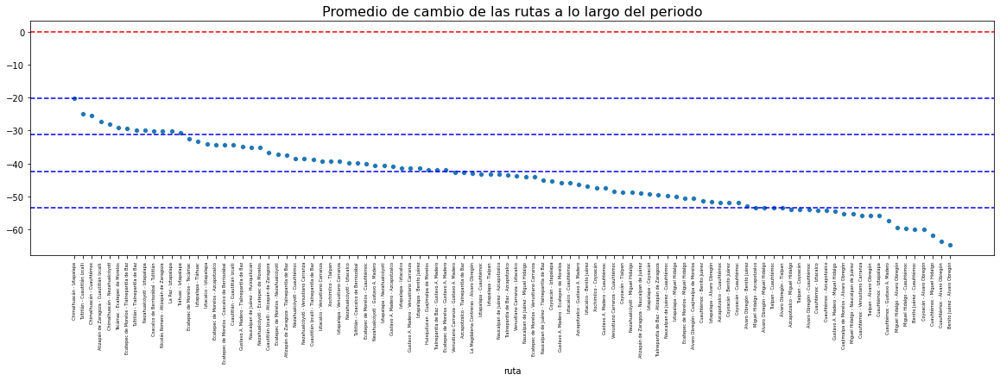

In [25]:
# Determinacion de los intervalos para los grupos
# Usamos quartiles
grafica_define_grupos(avg_top100_inter_8hr.index, avg_top100_inter_8hr, 0)

In [26]:
grupo1, grupo2, grupo3, grupo4, groupo_cat = asignar_rutas_en_grupos(top100_inter_8hr_panel, avg_top100_inter_8hr)

In [27]:
print('Grupo 1: ', groupo_cat[0], '\tN: ', grupo1.shape[0])
print('Grupo 2: ', groupo_cat[1], '\tN: ', grupo2.shape[0])
print('Grupo 3: ', groupo_cat[2], '\tN: ', grupo3.shape[0])
print('Grupo 4: ', groupo_cat[3], '\tN: ', grupo4.shape[0])

Grupo 1:  (-64.66, -53.516] 	N:  19
Grupo 2:  (-53.516, -42.417] 	N:  38
Grupo 3:  (-42.417, -31.317] 	N:  30
Grupo 4:  (-31.317, -20.218] 	N:  13


In [28]:
grupo_8h = []

grupo_8h.append(grupo1)
grupo_8h.append(grupo2)
grupo_8h.append(grupo3)
grupo_8h.append(grupo4)

In [76]:
for i in range(0,4):
    rutas = grupo_8h[i].index
    grafica2_cambio_en_en_tiempo_grupos(grupo_8h[i], rutas, "Grupo {}: 08 horas de Lunes a Viernes".format(i+1), 0)

### 1.2 Rutas más transitadas por día de la semana 

Solo días hábiles: Lunes a Viernes

In [30]:
lista_dias = ['Lunes', 'Martes', 'Miércoles', 'Jueves', 'Viernes']

In [31]:
# df por dia de la semana para las 08 horas
ruta_8hr_dias = []

for i,dia in enumerate(lista_dias):
    df = inter_rutas[(inter_rutas['dia_semana']==dia) & (inter_rutas['hr']==8)][['ruta','percent_change', 'fecha']].groupby(['ruta','fecha']).mean().unstack()
    ruta_8hr_dias.append(df)

In [32]:
#ruta_8hr_dias[0]
for i in range(0,5):
    print("numero de rutas para el dia {}: {:,}".format(lista_dias[i], ruta_8hr_dias[i].shape[0]))

numero de rutas para el dia Lunes: 1,019
numero de rutas para el dia Martes: 998
numero de rutas para el dia Miércoles: 1,001
numero de rutas para el dia Jueves: 1,010
numero de rutas para el dia Viernes: 1,016


In [77]:
# Como se comportan las 100 rutas mas transitadas por dia de la semana
top100_8hr_dia=[]

for i,dia in enumerate(lista_dias):
    df_aux = ruta_8hr_dias[i].loc[top100_inter_8hr_panel.index]
    
    # Porcentaje de cambio en el periodo de las 100 rutas mas transitadas por dia
    avg_top100 = df_aux.mean(axis=1, skipna=True).sort_values(ascending=False)
    #avg_top100_inter_00hr
    
    grupo1, grupo2, grupo3, grupo4, group_cat = asignar_rutas_en_grupos(df_aux, avg_top100)

    print('Grupo 1: ', group_cat[0], '\tN: ', grupo1.shape[0])
    print('Grupo 2: ', group_cat[1], '\tN: ', grupo2.shape[0])
    print('Grupo 3: ', group_cat[2], '\tN: ', grupo3.shape[0])
    print('Grupo 4: ', group_cat[3], '\tN: ', grupo4.shape[0])

    rutas = grupo1.index
    dias = grupo1.columns.get_level_values(1)
    grafica2_cambio_en_en_tiempo_grupos_dia_semana(grupo1, rutas, dias, "Grupo 1: 08 horas - {}".format(dia), 0)
    
    rutas = grupo2.index
    dias = grupo2.columns.get_level_values(1)
    grafica2_cambio_en_en_tiempo_grupos_dia_semana(grupo2, rutas, dias, "Grupo 2: 08 horas - {}".format(dia), 0)
    
    rutas = grupo3.index
    dias = grupo3.columns.get_level_values(1)
    grafica2_cambio_en_en_tiempo_grupos_dia_semana(grupo3, rutas, dias, "Grupo 3: 08 horas - {}".format(dia), 0)
    
    rutas = grupo4.index
    dias = grupo4.columns.get_level_values(1)
    grafica2_cambio_en_en_tiempo_grupos_dia_semana(grupo4, rutas, dias, "Grupo 4: 08 horas - {}".format(dia), 0)
    
    top100_8hr_dia.append(df_aux)

Grupo 1:  (-62.971, -51.442] 	N:  14
Grupo 2:  (-51.442, -39.958] 	N:  43
Grupo 3:  (-39.958, -28.475] 	N:  31
Grupo 4:  (-28.475, -16.991] 	N:  12


Grupo 1:  (-65.956, -54.49] 	N:  22
Grupo 2:  (-54.49, -43.069] 	N:  33
Grupo 3:  (-43.069, -31.649] 	N:  33
Grupo 4:  (-31.649, -20.228] 	N:  12


Grupo 1:  (-66.432, -54.748] 	N:  22
Grupo 2:  (-54.748, -43.111] 	N:  35
Grupo 3:  (-43.111, -31.474] 	N:  33
Grupo 4:  (-31.474, -19.836] 	N:  10


Grupo 1:  (-63.369, -53.028] 	N:  21
Grupo 2:  (-53.028, -42.728] 	N:  32
Grupo 3:  (-42.728, -32.428] 	N:  35
Grupo 4:  (-32.428, -22.127] 	N:  12


Grupo 1:  (-64.932, -54.083] 	N:  23
Grupo 2:  (-54.083, -43.277] 	N:  32
Grupo 3:  (-43.277, -32.471] 	N:  32
Grupo 4:  (-32.471, -21.665] 	N:  13


### 1.3  Rutas que desaparecieron

Definimos las rutas que desaparecieron como aquellas rutas cuyo porcentaje de NaN es mayor al 50% en todo el periodo considerado.


In [34]:
# Porcentaje de NaN por ruta
inter_rutas_nan = inter_rutas_8hr_panel.isnull().mean(axis=1).sort_values(ascending=False)*100
#inter_rutas_nan

In [35]:
# Rutas con % de missing values mayores al 50%
inter_rutas_desaparecidas_index = inter_rutas_nan[inter_rutas_nan.values>50].index
inter_rutas_desaparecidas = inter_rutas_8hr_panel.loc[inter_rutas_desaparecidas_index]

print("Rutas con % de nan > 50: ", inter_rutas_desaparecidas.shape[0])

Rutas con % de nan > 50:  316


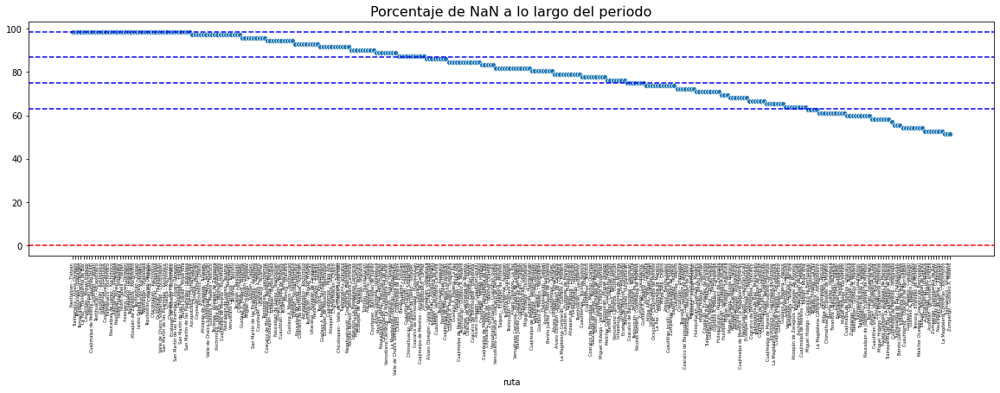

In [36]:
# Determinacion de los intervalos para los grupos
# Usamos quartiles
grafica_define_grupos(inter_rutas_desaparecidas_index, inter_rutas_nan.loc[inter_rutas_desaparecidas_index], 1)

In [37]:
grupo1, grupo2, grupo3, grupo4, group_cat = asignar_rutas_en_grupos(inter_rutas_desaparecidas, inter_rutas_nan.loc[inter_rutas_desaparecidas_index])

In [38]:
print('Grupo 1: ', group_cat[0], '\tN: ', grupo1.shape[0])
print('Grupo 2: ', group_cat[1], '\tN: ', grupo2.shape[0])
print('Grupo 3: ', group_cat[2], '\tN: ', grupo3.shape[0])
print('Grupo 4: ', group_cat[3], '\tN: ', grupo4.shape[0])

Grupo 1:  (51.342, 63.194] 	N:  52
Grupo 2:  (63.194, 75.0] 	N:  65
Grupo 3:  (75.0, 86.806] 	N:  72
Grupo 4:  (86.806, 98.611] 	N:  127


In [39]:
grupo_8h_nan = []

grupo_8h_nan.append(grupo1)
grupo_8h_nan.append(grupo2)
grupo_8h_nan.append(grupo3)
grupo_8h_nan.append(grupo4)

In [40]:
for i in range(0,4):
    rutas = grupo_8h_nan[i].index
    grafica2_cambio_en_en_tiempo_grupos(grupo_8h_nan[i], rutas, "Grupo {}: 08 horas de Lunes a Viernes".format(i+1), 1)


### 1.4 Rutas que desaparecieron por dia de la semana
 


In [41]:
# Como se comportan las rutas con NaN > 50% por dia de la semana
nan_8hr_dia=[]

for i,dia in enumerate(lista_dias):
    # Porcentaje de nan
    nan_mas50 = ruta_8hr_dias[i].isnull().mean(axis=1).sort_values(ascending=False)*100
    # Selecciono rutas por dia con %NaN>50
    nan_mas50 = nan_mas50[nan_mas50>50]
    
    # panel para Rutas con %NaN>50
    df_aux = ruta_8hr_dias[i].loc[nan_mas50.index]
    
    grupo1, grupo2, grupo3, grupo4, group_cat = asignar_rutas_en_grupos(df_aux, nan_mas50)

    print('Grupo 1: ', group_cat[0], '\tN: ', grupo1.shape[0])
    print('Grupo 2: ', group_cat[1], '\tN: ', grupo2.shape[0])
    print('Grupo 3: ', group_cat[2], '\tN: ', grupo3.shape[0])
    print('Grupo 4: ', group_cat[3], '\tN: ', grupo4.shape[0])

    rutas = grupo1.index
    dias = grupo1.columns.get_level_values(1)
    grafica2_cambio_en_en_tiempo_grupos_dia_semana(grupo1, rutas, dias, "Grupo 1: 08 horas - {}".format(dia), 1)
    
    rutas = grupo2.index
    dias = grupo2.columns.get_level_values(1)
    grafica2_cambio_en_en_tiempo_grupos_dia_semana(grupo2, rutas, dias, "Grupo 2: 08 horas - {}".format(dia), 1)
    
    rutas = grupo3.index
    dias = grupo3.columns.get_level_values(1)
    grafica2_cambio_en_en_tiempo_grupos_dia_semana(grupo3, rutas, dias, "Grupo 3: 08 horas - {}".format(dia), 1)
    
    rutas = grupo4.index
    dias = grupo4.columns.get_level_values(1)
    grafica2_cambio_en_en_tiempo_grupos_dia_semana(grupo4, rutas, dias, "Grupo 4: 08 horas - {}".format(dia), 1)
    
    nan_8hr_dia.append(df_aux)

Grupo 1:  (57.107, 66.071] 	N:  57
Grupo 2:  (66.071, 75.0] 	N:  32
Grupo 3:  (75.0, 83.929] 	N:  31
Grupo 4:  (83.929, 92.857] 	N:  111


Grupo 1:  (57.107, 66.071] 	N:  47
Grupo 2:  (66.071, 75.0] 	N:  28
Grupo 3:  (75.0, 83.929] 	N:  47
Grupo 4:  (83.929, 92.857] 	N:  62


Grupo 1:  (57.107, 66.071] 	N:  57
Grupo 2:  (66.071, 75.0] 	N:  49
Grupo 3:  (75.0, 83.929] 	N:  51
Grupo 4:  (83.929, 92.857] 	N:  48


Grupo 1:  (53.293, 63.333] 	N:  46
Grupo 2:  (63.333, 73.333] 	N:  97
Grupo 3:  (73.333, 83.333] 	N:  39
Grupo 4:  (83.333, 93.333] 	N:  36


Grupo 1:  (53.293, 63.333] 	N:  56
Grupo 2:  (63.333, 73.333] 	N:  82
Grupo 3:  (73.333, 83.333] 	N:  46
Grupo 4:  (83.333, 93.333] 	N:  47


## 2. Ventana de tiempo: 16 horas

### 2.1 Top 100 rutas más transitadas

Tomando en cuenta solo de Lunes a Viernes.


In [42]:
# Rutas registradas en la ventana de las 8 horas
inter_rutas_16hr = inter_rutas.loc[inter_rutas['hr']==16 & (inter_rutas['dia_semana']!='Sábado') &
                                  (inter_rutas['dia_semana']!='Domingo'),['ruta', 'hr', 'fecha', 'percent_change', 'crisis_people_moving']]
inter_rutas_16hr_panel = inter_rutas_16hr.groupby(['ruta', 'fecha']).mean()['percent_change'].unstack()

In [43]:
# Las 100 rutas mas transitadas 
top100_inter_16hr = inter_rutas_16hr.groupby(['ruta']).sum().sort_values(['crisis_people_moving'],ascending=False)[:100][['crisis_people_moving']]

# Porcentaje de personas que cubren las rutas top 100
(top100_inter_16hr['crisis_people_moving'].sum()/inter_rutas_16hr[['crisis_people_moving']].sum()[0])*100

# Prety print
#top100_inter_16hr.round(0).style.format('{:,}')

53.99479379386839

In [44]:
# Porcentaje de cambio en el periodo de las 100 rutas mas transitadas
top100_inter_16hr_panel = inter_rutas_16hr_panel[inter_rutas_16hr_panel.index.isin(top100_inter_16hr.index)]
avg_top100_inter_16hr = top100_inter_16hr_panel.mean(axis=1, skipna=True).sort_values(ascending=False)
#avg_top100_inter_16hr 

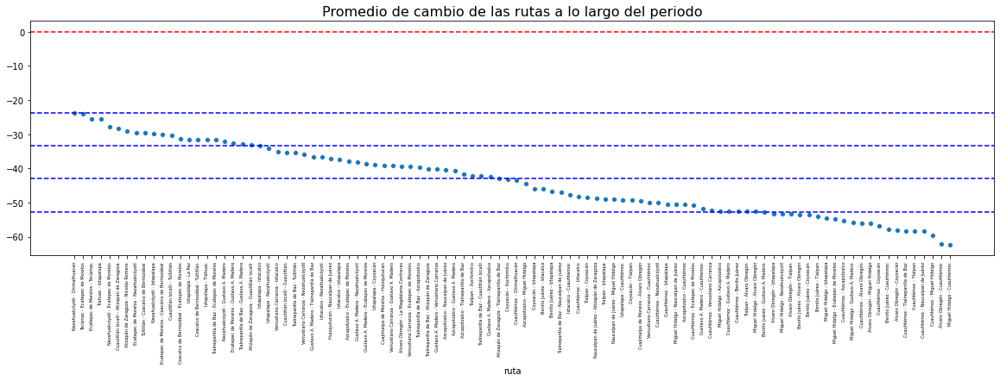

In [45]:
# Determinacion de los intervalos para los grupos
# Usamos quartiles
grafica_define_grupos(avg_top100_inter_16hr.index, avg_top100_inter_16hr, 0)

In [46]:
grupo1, grupo2, grupo3, grupo4, group_cat = asignar_rutas_en_grupos(top100_inter_16hr_panel, avg_top100_inter_16hr)

print('Grupo 1: ', group_cat[0], '\tN: ', grupo1.shape[0])
print('Grupo 2: ', group_cat[1], '\tN: ', grupo2.shape[0])
print('Grupo 3: ', group_cat[2], '\tN: ', grupo3.shape[0])
print('Grupo 4: ', group_cat[3], '\tN: ', grupo4.shape[0])

Grupo 1:  (-62.355, -52.663] 	N:  22
Grupo 2:  (-52.663, -43.01] 	N:  29
Grupo 3:  (-43.01, -33.356] 	N:  27
Grupo 4:  (-33.356, -23.703] 	N:  22


In [47]:
grupo_16h = []

grupo_16h.append(grupo1)
grupo_16h.append(grupo2)
grupo_16h.append(grupo3)
grupo_16h.append(grupo4)

In [48]:
for i in range(0,4):
    rutas = grupo_16h[i].index
    grafica2_cambio_en_en_tiempo_grupos(grupo_16h[i], rutas, "Grupo {}: 16 horas de Lunes a Viernes".format(i+1), 0)

### 2.2 Rutas más transitadas por día de la semana

Solo días hábiles: Lunes a Viernes


In [49]:
# df por dia de la semana para las 16 horas
ruta_16hr_dias = []

for i,dia in enumerate(lista_dias):
    df = inter_rutas[(inter_rutas['dia_semana']==dia) & (inter_rutas['hr']==16)][['ruta','percent_change', 'fecha']].groupby(['ruta','fecha']).mean().unstack()
    ruta_16hr_dias.append(df)

In [50]:
# Como se comportan las 100 rutas mas transitads por dia de la semana
top100_16hr_dia=[]

for i,dia in enumerate(lista_dias):
    df_aux = ruta_16hr_dias[i].loc[top100_inter_16hr_panel.index]
    
    # Porcentaje de cambio en el periodo de las 100 rutas mas transitadas por dia
    avg_top100 = df_aux.mean(axis=1, skipna=True).sort_values(ascending=False)
    #avg_top100_inter_00hr
    
    grupo1, grupo2, grupo3, grupo4, group_cat = asignar_rutas_en_grupos(df_aux, avg_top100)

    print('Grupo 1: ', group_cat[0], '\tN: ', grupo1.shape[0])
    print('Grupo 2: ', group_cat[1], '\tN: ', grupo2.shape[0])
    print('Grupo 3: ', group_cat[2], '\tN: ', grupo3.shape[0])
    print('Grupo 4: ', group_cat[3], '\tN: ', grupo4.shape[0])

    rutas = grupo1.index
    dias = grupo1.columns.get_level_values(1)
    grafica2_cambio_en_en_tiempo_grupos_dia_semana(grupo1, rutas, dias, "Grupo 1: 16 horas - {}".format(dia), 0)
    
    rutas = grupo2.index
    dias = grupo2.columns.get_level_values(1)
    grafica2_cambio_en_en_tiempo_grupos_dia_semana(grupo2, rutas, dias, "Grupo 2: 16 horas - {}".format(dia), 0)
    
    rutas = grupo3.index
    dias = grupo3.columns.get_level_values(1)
    grafica2_cambio_en_en_tiempo_grupos_dia_semana(grupo3, rutas, dias, "Grupo 3: 16 horas - {}".format(dia), 0)
    
    rutas = grupo4.index
    dias = grupo4.columns.get_level_values(1)
    grafica2_cambio_en_en_tiempo_grupos_dia_semana(grupo4, rutas, dias, "Grupo 4: 16 horas - {}".format(dia), 0)
    
    top100_16hr_dia.append(df_aux)


Grupo 1:  (-63.62, -48.981] 	N:  29
Grupo 2:  (-48.981, -34.4] 	N:  44
Grupo 3:  (-34.4, -19.82] 	N:  24
Grupo 4:  (-19.82, -5.239] 	N:  3


Grupo 1:  (-63.791, -50.104] 	N:  27
Grupo 2:  (-50.104, -36.472] 	N:  36
Grupo 3:  (-36.472, -22.84] 	N:  33
Grupo 4:  (-22.84, -9.208] 	N:  4


Grupo 1:  (-64.683, -49.668] 	N:  29
Grupo 2:  (-49.668, -34.713] 	N:  43
Grupo 3:  (-34.713, -19.757] 	N:  25
Grupo 4:  (-19.757, -4.802] 	N:  3


Grupo 1:  (-62.076, -48.435] 	N:  28
Grupo 2:  (-48.435, -34.849] 	N:  38
Grupo 3:  (-34.849, -21.262] 	N:  31
Grupo 4:  (-21.262, -7.676] 	N:  3


Grupo 1:  (-61.571, -50.423] 	N:  24
Grupo 2:  (-50.423, -39.319] 	N:  33
Grupo 3:  (-39.319, -28.215] 	N:  30
Grupo 4:  (-28.215, -17.11] 	N:  13


### 2.3 Rutas que desaparecieron

Definimos las rutas que desaparecieron como aquellas rutas cuyo porcentaje de NaN es mayor al 50% en todo el periodo considerado.


In [51]:
# Porcentaje de NaN por ruta
inter_rutas_nan_16hr = inter_rutas_16hr_panel.isnull().mean(axis=1).sort_values(ascending=False)*100
#inter_rutas_nan_16hr

In [52]:
# Rutas con % de missing values mayores al 50%
inter_rutas_16hr_desaparecidas_index = inter_rutas_nan_16hr[inter_rutas_nan_16hr.values>50].index
inter_rutas_16hr_desaparecidas = inter_rutas_16hr_panel.loc[inter_rutas_16hr_desaparecidas_index]

print("Rutas con % de nan > 50: ", inter_rutas_16hr_desaparecidas.shape[0])

Rutas con % de nan > 50:  439


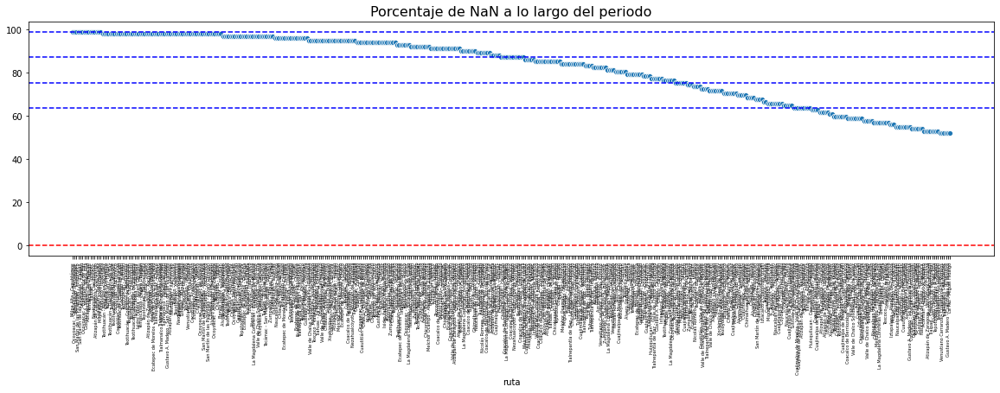

In [53]:
# Determinacion de los intervalos para los grupos
# Usamos quartiles
grafica_define_grupos(inter_rutas_16hr_desaparecidas_index, inter_rutas_nan_16hr.loc[inter_rutas_16hr_desaparecidas_index], 1)

In [54]:
grupo1, grupo2, grupo3, grupo4, group_cat = asignar_rutas_en_grupos(inter_rutas_16hr_desaparecidas, inter_rutas_nan_16hr.loc[inter_rutas_16hr_desaparecidas_index])

print('Grupo 1: ', group_cat[0], '\tN: ', grupo1.shape[0])
print('Grupo 2: ', group_cat[1], '\tN: ', grupo2.shape[0])
print('Grupo 3: ', group_cat[2], '\tN: ', grupo3.shape[0])
print('Grupo 4: ', group_cat[3], '\tN: ', grupo4.shape[0])

Grupo 1:  (51.914, 63.725] 	N:  79
Grupo 2:  (63.725, 75.49] 	N:  59
Grupo 3:  (75.49, 87.255] 	N:  87
Grupo 4:  (87.255, 99.02] 	N:  214


In [55]:
grupo_16h_nan = []

grupo_16h_nan.append(grupo1)
grupo_16h_nan.append(grupo2)
grupo_16h_nan.append(grupo3)
grupo_16h_nan.append(grupo4)

In [56]:
for i in range(0,4):
    rutas = grupo_16h_nan[i].index
    grafica2_cambio_en_en_tiempo_grupos(grupo_16h_nan[i], rutas, "Grupo {}: 16 horas de Lunes a Viernes".format(i+1), 1)

### 2.4 Rutas que desaparecieron por dia de la semana
 

In [57]:
# Como se comportan las rutas con NaN > 50% por dia de la semana
nan_16hr_dia=[]

for i,dia in enumerate(lista_dias):
    # Porcentaje de nan
    nan_mas50 = ruta_16hr_dias[i].isnull().mean(axis=1).sort_values(ascending=False)*100
    # Selecciono rutas por dia con %NaN>50
    nan_mas50 = nan_mas50[nan_mas50>50]
    
    # panel para Rutas con %NaN>50
    df_aux = ruta_16hr_dias[i].loc[nan_mas50.index]
    
    grupo1, grupo2, grupo3, grupo4, group_cat = asignar_rutas_en_grupos(df_aux, nan_mas50)

    print('Grupo 1: ', group_cat[0], '\tN: ', grupo1.shape[0])
    print('Grupo 2: ', group_cat[1], '\tN: ', grupo2.shape[0])
    print('Grupo 3: ', group_cat[2], '\tN: ', grupo3.shape[0])
    print('Grupo 4: ', group_cat[3], '\tN: ', grupo4.shape[0])

    rutas = grupo1.index
    dias = grupo1.columns.get_level_values(1)
    grafica2_cambio_en_en_tiempo_grupos_dia_semana(grupo1, rutas, dias, "Grupo 1: 08 horas - {}".format(dia), 1)
    
    rutas = grupo2.index
    dias = grupo2.columns.get_level_values(1)
    grafica2_cambio_en_en_tiempo_grupos_dia_semana(grupo2, rutas, dias, "Grupo 2: 08 horas - {}".format(dia), 1)
    
    rutas = grupo3.index
    dias = grupo3.columns.get_level_values(1)
    grafica2_cambio_en_en_tiempo_grupos_dia_semana(grupo3, rutas, dias, "Grupo 3: 08 horas - {}".format(dia), 1)
    
    rutas = grupo4.index
    dias = grupo4.columns.get_level_values(1)
    grafica2_cambio_en_en_tiempo_grupos_dia_semana(grupo4, rutas, dias, "Grupo 4: 08 horas - {}".format(dia), 1)
    
    nan_16hr_dia.append(df_aux)

Grupo 1:  (57.107, 66.071] 	N:  61
Grupo 2:  (66.071, 75.0] 	N:  39
Grupo 3:  (75.0, 83.929] 	N:  34
Grupo 4:  (83.929, 92.857] 	N:  102


Grupo 1:  (57.107, 66.071] 	N:  71
Grupo 2:  (66.071, 75.0] 	N:  46
Grupo 3:  (75.0, 83.929] 	N:  51
Grupo 4:  (83.929, 92.857] 	N:  41


Grupo 1:  (57.107, 66.071] 	N:  72
Grupo 2:  (66.071, 75.0] 	N:  37
Grupo 3:  (75.0, 83.929] 	N:  47
Grupo 4:  (83.929, 92.857] 	N:  43


Grupo 1:  (53.293, 63.333] 	N:  67
Grupo 2:  (63.333, 73.333] 	N:  90
Grupo 3:  (73.333, 83.333] 	N:  31
Grupo 4:  (83.333, 93.333] 	N:  35


Grupo 1:  (53.293, 63.333] 	N:  73
Grupo 2:  (63.333, 73.333] 	N:  86
Grupo 3:  (73.333, 83.333] 	N:  35
Grupo 4:  (83.333, 93.333] 	N:  27


## 3. Ventana de tiempo: 00 horas

### 3.1 Top 100 rutas más transitadas

Tomando en cuenta solo de Lunes a Viernes.

In [58]:
# Rutas registradas en la ventana de las 8 horas
inter_rutas_00hr = inter_rutas.loc[(inter_rutas['hr']==0) &  (inter_rutas['dia_semana']!='Sábado') &
                                  (inter_rutas['dia_semana']!='Domingo') ,['ruta', 'hr', 'fecha', 'percent_change', 'crisis_people_moving']]
inter_rutas_00hr_panel = inter_rutas_00hr.groupby(['ruta', 'fecha']).mean()['percent_change'].unstack()

In [59]:
# Las 100 rutas mas transitadas 
top100_inter_00hr = inter_rutas_00hr.groupby(['ruta']).sum().sort_values(['crisis_people_moving'],ascending=False)[:100][['crisis_people_moving']]

# Porcentaje de personas que cubren las rutas top 100
(top100_inter_00hr['crisis_people_moving'].sum()/inter_rutas_00hr[['crisis_people_moving']].sum()[0])*100

# Prety print
#top100_inter_00hr.round(0).style.format('{:,}')

54.214064724435296

In [60]:
# Porcentaje de cambio en el periodo de las 100 rutas mas transitadas
top100_inter_00hr_panel = inter_rutas_00hr_panel[inter_rutas_00hr_panel.index.isin(top100_inter_00hr.index)]
avg_top100_inter_00hr = top100_inter_00hr_panel.mean(axis=1, skipna=True).sort_values(ascending=False)
#avg_top100_inter_00hr

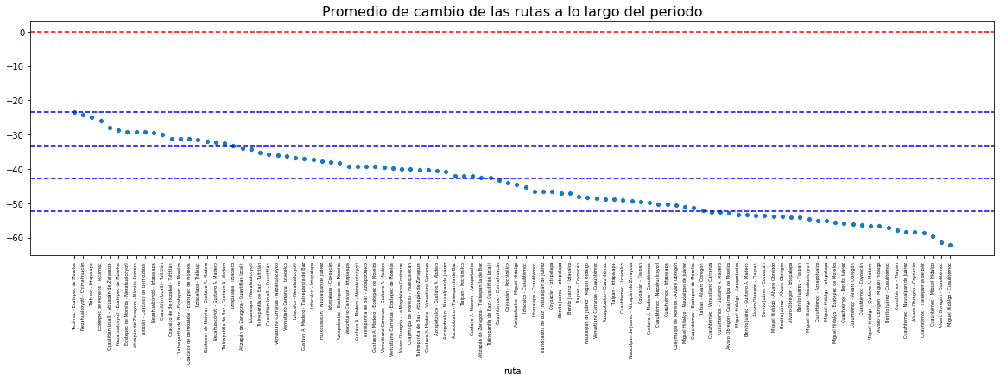

In [61]:
# Determinacion de los intervalos para los grupos
# Usamos quartiles
grafica_define_grupos(avg_top100_inter_00hr.index, avg_top100_inter_00hr, 0)

In [62]:
grupo1, grupo2, grupo3, grupo4, group_cat = asignar_rutas_en_grupos(top100_inter_00hr_panel, avg_top100_inter_00hr)

print('Grupo 1: ', group_cat[0], '\tN: ', grupo1.shape[0])
print('Grupo 2: ', group_cat[1], '\tN: ', grupo2.shape[0])
print('Grupo 3: ', group_cat[2], '\tN: ', grupo3.shape[0])
print('Grupo 4: ', group_cat[3], '\tN: ', grupo4.shape[0])

Grupo 1:  (-62.096, -52.429] 	N:  28
Grupo 2:  (-52.429, -42.801] 	N:  24
Grupo 3:  (-42.801, -33.173] 	N:  30
Grupo 4:  (-33.173, -23.545] 	N:  18


In [63]:
grupo_00h = []

grupo_00h.append(grupo1)
grupo_00h.append(grupo2)
grupo_00h.append(grupo3)
grupo_00h.append(grupo4)

In [64]:
for i in range(0,4):
    rutas = grupo_00h[i].index
    grafica2_cambio_en_en_tiempo_grupos(grupo_00h[i], rutas, "Grupo {}: 00 horas de Lunes a Viernes".format(i+1), 0)

### 3.2 Rutas más transitadas por día de la semana




In [65]:
# df por dia de la semana para las 16 horas
ruta_00hr_dias = []

for i,dia in enumerate(lista_dias):
    df = inter_rutas[(inter_rutas['dia_semana']==dia) & (inter_rutas['hr']==16)][['ruta','percent_change', 'fecha']].groupby(['ruta','fecha']).mean().unstack()
    ruta_00hr_dias.append(df)

In [66]:
# Como se comportan las 100 rutas mas transitads por dia de la semana
top100_00hr_dia=[]

for i,dia in enumerate(lista_dias):
    df_aux = ruta_00hr_dias[i].loc[top100_inter_00hr_panel.index]
    
    # Porcentaje de cambio en el periodo de las 100 rutas mas transitadas por dia
    avg_top100 = df_aux.mean(axis=1, skipna=True).sort_values(ascending=False)
    #avg_top100_inter_00hr
    
    grupo1, grupo2, grupo3, grupo4, group_cat = asignar_rutas_en_grupos(df_aux, avg_top100)

    print('Grupo 1: ', group_cat[0], '\tN: ', grupo1.shape[0])
    print('Grupo 2: ', group_cat[1], '\tN: ', grupo2.shape[0])
    print('Grupo 3: ', group_cat[2], '\tN: ', grupo3.shape[0])
    print('Grupo 4: ', group_cat[3], '\tN: ', grupo4.shape[0])

    rutas = grupo1.index
    dias = grupo1.columns.get_level_values(1)
    grafica2_cambio_en_en_tiempo_grupos_dia_semana(grupo1, rutas, dias, "Grupo 1: 00 horas - {}".format(dia), 0)
    
    rutas = grupo2.index
    dias = grupo2.columns.get_level_values(1)
    grafica2_cambio_en_en_tiempo_grupos_dia_semana(grupo2, rutas, dias, "Grupo 2: 00 horas - {}".format(dia), 0)
    
    rutas = grupo3.index
    dias = grupo3.columns.get_level_values(1)
    grafica2_cambio_en_en_tiempo_grupos_dia_semana(grupo3, rutas, dias, "Grupo 3: 00 horas - {}".format(dia), 0)
    
    rutas = grupo4.index
    dias = grupo4.columns.get_level_values(1)
    grafica2_cambio_en_en_tiempo_grupos_dia_semana(grupo4, rutas, dias, "Grupo 4: 00 horas - {}".format(dia), 0)
    
    top100_00hr_dia.append(df_aux)

Grupo 1:  (-63.62, -48.981] 	N:  30
Grupo 2:  (-48.981, -34.4] 	N:  44
Grupo 3:  (-34.4, -19.82] 	N:  23
Grupo 4:  (-19.82, -5.239] 	N:  3


Grupo 1:  (-63.791, -50.104] 	N:  28
Grupo 2:  (-50.104, -36.472] 	N:  37
Grupo 3:  (-36.472, -22.84] 	N:  31
Grupo 4:  (-22.84, -9.208] 	N:  4


Grupo 1:  (-64.683, -49.668] 	N:  30
Grupo 2:  (-49.668, -34.713] 	N:  43
Grupo 3:  (-34.713, -19.757] 	N:  25
Grupo 4:  (-19.757, -4.802] 	N:  2


Grupo 1:  (-62.076, -48.435] 	N:  29
Grupo 2:  (-48.435, -34.849] 	N:  39
Grupo 3:  (-34.849, -21.262] 	N:  30
Grupo 4:  (-21.262, -7.676] 	N:  2


Grupo 1:  (-61.571, -50.423] 	N:  25
Grupo 2:  (-50.423, -39.319] 	N:  34
Grupo 3:  (-39.319, -28.215] 	N:  29
Grupo 4:  (-28.215, -17.11] 	N:  12


### 3.3 Rutas que desaparecieron

Definimos las rutas que desaparecieron como aquellas rutas cuyo porcentaje de NaN es mayor al 50% en todo el periodo considerado.

In [67]:
# Porcentaje de NaN por ruta
inter_rutas_nan_00hr = inter_rutas_00hr_panel.isnull().mean(axis=1).sort_values(ascending=False)*100
#inter_rutas_nan_00hr

In [68]:
# Rutas con % de missing values mayores al 50%
inter_rutas_00hr_desaparecidas_index = inter_rutas_nan_00hr[inter_rutas_nan_00hr.values>50].index
inter_rutas_00hr_desaparecidas = inter_rutas_00hr_panel.loc[inter_rutas_00hr_desaparecidas_index]

print("Rutas con % de nan > 50: ", inter_rutas_00hr_desaparecidas.shape[0])

Rutas con % de nan > 50:  406


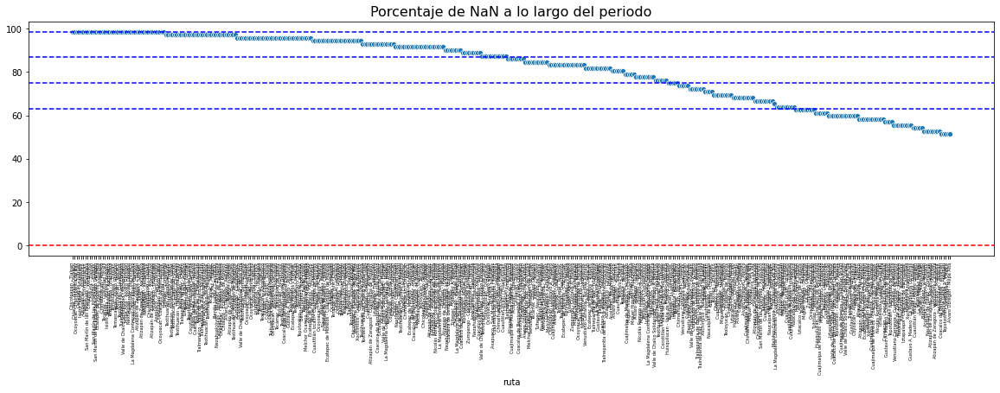

In [69]:
# Determinacion de los intervalos para los grupos
# Usamos quartiles
grafica_define_grupos(inter_rutas_00hr_desaparecidas_index, inter_rutas_nan_00hr.loc[inter_rutas_00hr_desaparecidas_index], 1)

In [70]:
grupo1, grupo2, grupo3, grupo4, group_cat = asignar_rutas_en_grupos(inter_rutas_00hr_desaparecidas, inter_rutas_nan_00hr.loc[inter_rutas_00hr_desaparecidas_index])

print('Grupo 1: ', group_cat[0], '\tN: ', grupo1.shape[0])
print('Grupo 2: ', group_cat[1], '\tN: ', grupo2.shape[0])
print('Grupo 3: ', group_cat[2], '\tN: ', grupo3.shape[0])
print('Grupo 4: ', group_cat[3], '\tN: ', grupo4.shape[0])

Grupo 1:  (51.342, 63.194] 	N:  72
Grupo 2:  (63.194, 75.0] 	N:  59
Grupo 3:  (75.0, 86.806] 	N:  74
Grupo 4:  (86.806, 98.611] 	N:  201


In [71]:
grupo_00h_nan = []

grupo_00h_nan.append(grupo1)
grupo_00h_nan.append(grupo2)
grupo_00h_nan.append(grupo3)
grupo_00h_nan.append(grupo4)

In [72]:
for i in range(0,4):
    rutas = grupo_00h_nan[i].index
    grafica2_cambio_en_en_tiempo_grupos(grupo_00h_nan[i], rutas, "Grupo {}: 00 horas de Lunes a Viernes".format(i+1), 1)

### 3.4 Rutas que desaparecieron por dia de la semana

In [73]:
# Como se comportan las rutas con NaN > 50% por dia de la semana
nan_00hr_dia=[]

for i,dia in enumerate(lista_dias):
    # Porcentaje de nan
    nan_mas50 = ruta_00hr_dias[i].isnull().mean(axis=1).sort_values(ascending=False)*100
    # Selecciono rutas por dia con %NaN>50
    nan_mas50 = nan_mas50[nan_mas50>50]
    
    # panel para Rutas con %NaN>50
    df_aux = ruta_00hr_dias[i].loc[nan_mas50.index]
    
    grupo1, grupo2, grupo3, grupo4, group_cat = asignar_rutas_en_grupos(df_aux, nan_mas50)

    print('Grupo 1: ', group_cat[0], '\tN: ', grupo1.shape[0])
    print('Grupo 2: ', group_cat[1], '\tN: ', grupo2.shape[0])
    print('Grupo 3: ', group_cat[2], '\tN: ', grupo3.shape[0])
    print('Grupo 4: ', group_cat[3], '\tN: ', grupo4.shape[0])

    rutas = grupo1.index
    dias = grupo1.columns.get_level_values(1)
    grafica2_cambio_en_en_tiempo_grupos_dia_semana(grupo1, rutas, dias, "Grupo 1: 08 horas - {}".format(dia), 1)
    
    rutas = grupo2.index
    dias = grupo2.columns.get_level_values(1)
    grafica2_cambio_en_en_tiempo_grupos_dia_semana(grupo2, rutas, dias, "Grupo 2: 08 horas - {}".format(dia), 1)
    
    rutas = grupo3.index
    dias = grupo3.columns.get_level_values(1)
    grafica2_cambio_en_en_tiempo_grupos_dia_semana(grupo3, rutas, dias, "Grupo 3: 08 horas - {}".format(dia), 1)
    
    rutas = grupo4.index
    dias = grupo4.columns.get_level_values(1)
    grafica2_cambio_en_en_tiempo_grupos_dia_semana(grupo4, rutas, dias, "Grupo 4: 08 horas - {}".format(dia), 1)
    
    nan_00hr_dia.append(df_aux)

Grupo 1:  (57.107, 66.071] 	N:  61
Grupo 2:  (66.071, 75.0] 	N:  39
Grupo 3:  (75.0, 83.929] 	N:  34
Grupo 4:  (83.929, 92.857] 	N:  102


Grupo 1:  (57.107, 66.071] 	N:  71
Grupo 2:  (66.071, 75.0] 	N:  46
Grupo 3:  (75.0, 83.929] 	N:  51
Grupo 4:  (83.929, 92.857] 	N:  41


Grupo 1:  (57.107, 66.071] 	N:  72
Grupo 2:  (66.071, 75.0] 	N:  37
Grupo 3:  (75.0, 83.929] 	N:  47
Grupo 4:  (83.929, 92.857] 	N:  43


Grupo 1:  (53.293, 63.333] 	N:  67
Grupo 2:  (63.333, 73.333] 	N:  90
Grupo 3:  (73.333, 83.333] 	N:  31
Grupo 4:  (83.333, 93.333] 	N:  35


Grupo 1:  (53.293, 63.333] 	N:  73
Grupo 2:  (63.333, 73.333] 	N:  86
Grupo 3:  (73.333, 83.333] 	N:  35
Grupo 4:  (83.333, 93.333] 	N:  27
